UNRISK training: Comparing models to field observations

Date: 19th December 2025

Academic lead: Declan Finney (d.l.finney@leeds.ac.uk)

Postdoctoral researcher support: Ezri Alkilani-Brown

Additional preparation support: Xinyi Huang

Associated UNRISK webinar: Instrumentation & Gathering uncertainty data (9th December 2025)

Workshop schedule (maybe):

09:00-10:00 -- Part 1: Evaluation of cloud dynamics and convective growth

10:00-10:30 -- Break

10:30-12:00 -- Part 2: Evaluation of cloud microphysics and graupel concentration


PART 1A: GETTING A FEEL FOR THE OBSERVATIONS

Read in the aircraft core data for the 31st July 2022, get a summary of its contents, and quick-plot the aircraft altitude.

_Hints_: ALT_GIN is the variable needed, and .plot() should be sufficient once it's selected.

In [25]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

data_path = "~/scripts/UNRISK_wkshp/Part 1/Materials/"

In [4]:
# Read in data
ds_aircraft_core = xr.open_dataset(data_path+"aircraft_data/core_faam_20220731_v005_r0_c308_1hz.nc")

In [28]:
# Access interactive summary
ds_aircraft_core

<xarray.Dataset> Size: 18MB
Dimensions:              (Time: 24363)
Coordinates:
  * Time                 (Time) datetime64[ns] 195kB 2022-07-31T13:29:47 ... ...
    LAT_GIN              (Time) float32 97kB ...
    LON_GIN              (Time) float32 97kB ...
Data variables: (12/178)
    P10_STAT             (Time) float32 97kB ...
    P10_STAT_FLAG        (Time) float32 97kB ...
    EXX_JCI              (Time) float32 97kB ...
    EXX_JCI_FLAG         (Time) float32 97kB ...
    LAT_GIN_FLAG         (Time) float32 97kB ...
    LON_GIN_FLAG         (Time) float32 97kB ...
    ...                   ...
    SEA_TWC_083          (Time) float32 97kB ...
    SEA_TWC_083_FLAG     (Time) float32 97kB ...
    SEA_LWC_021          (Time) float32 97kB ...
    SEA_LWC_021_FLAG     (Time) float32 97kB ...
    SEA_LWC_083          (Time) float32 97kB ...
    SEA_LWC_083_FLAG     (Time) float32 97kB ...
Attributes: (12/60)
    Conventions:                           CF-1.9 ACDD-1.3
    acknowledgement:                       Airborne data was obtained using t...
    comment:                               DCMEX science flight around Langmu...
    constants_file:                        flight-cst_faam_20220731_r0_c308.yaml
    creator_address:                       Building 146, Cranfield University...
    creator_email:                         info@faam.ac.uk
    ...                                    ...
    summary:                               Data gathered during flight c308 o...
    time_coverage_duration:                PT6H46M2S
    time_coverage_end:                     2022-07-31T20:15:49Z
    time_coverage_start:                   2022-07-31T13:29:47Z
    title:                                 FAAM core data from c308
    uuid:                                  30771775-8844-38c3-aa17-2deb31aced11

Q1: What frequency are the measurements?

A1: #REMOVE 1Hz

Q2: What is the flight number for this case?

A2: #REMOVE c308

Q3: Where can you find more about how the instruments used to collect this data?

A3: #REMOVE https://doi.org/10.5281/zenodo.5846962

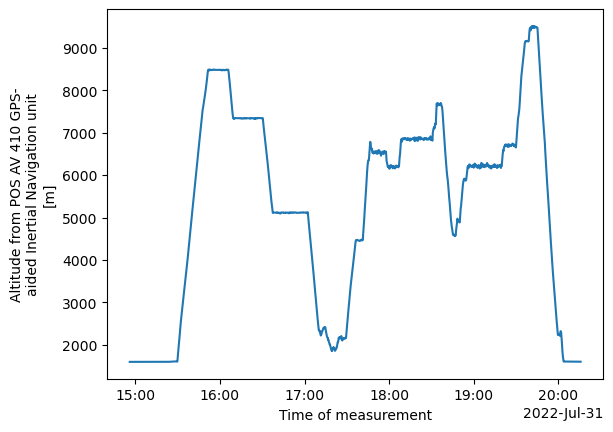

In [20]:
# TASK 1 Plot the aircraft altitude time series
# Hints: ALT_GIN is the variable needed, and .plot() should be sufficient once its selected.

# Your code goes here...

ds_aircraft_core["ALT_GIN"].plot() #REMOVE 

Q4: Use section 2 of the campaign data paper to decribe what the aircraft is doing at different times duing this time series.

https://doi.org/10.5194/essd-16-2141-2024 and in the Materials/papers folder

A4: #REMOVE Take-of around 15:30; ascent and dropsonde around 16:00;  2x aerosol kites prior to 17:00; BL aerosol kite after 17:00; likely cloud passes from about 17:30 to 19:45; returned to land around 20:00.

Q5: What is odd about the altitude before take-off?

A5: #REMOVE It is not zero when the aircraft is on the ground. ...because this is altitude above sea level, not above ground.

Q6: What is a "dropsonde"? What is an "aerosol kite"? Why might the aircraft have done these first, before measuring cloud?

A6: #REMOVE i) an instrument dropped from the aircraft to measure the vertical profile of temperature, humidity and wind. ii) A flight pattern when aerosol was measured. iii) to characterise the environment within which the clouds formed.

Q7: Why is the boundary-layer aerosol kite different to high level aerosol kites?

A7: #REMOVE because this is mountainous terrain and the aircraft has to fly "terrain-following", i.e. to rise and fall with that terrain, when flying low.

Let's check that we know when we were measuring cloud. We will use the Nevzerov instrument.

TASK 2: Summarise and plot the variable, NV_TWC_U.

In [36]:
# Your summary code goes here...

ds_aircraft_core["NV_TWC_U"] #REMOVE

<xarray.DataArray 'NV_TWC_U' (Time: 24363)> Size: 97kB
[24363 values with dtype=float32]
Coordinates:
  * Time     (Time) datetime64[ns] 195kB 2022-07-31T13:29:47 ... 2022-07-31T2...
    LAT_GIN  (Time) float32 97kB ...
    LON_GIN  (Time) float32 97kB ...
Attributes:
    actual_range:              [0.02277358 2.704461  ]
    ancillary_variables:       NV_TWC_U_FLAG
    coverage_content_type:     physicalMeasurement
    frequency:                 1
    instrument_manufacturer:   Sky Phys Tech Inc.
    instrument_model:          1T2L1R
    instrument_serial_number:  SN419
    long_name:                 Uncorrected total condensed water content from...
    units:                     gram m-3

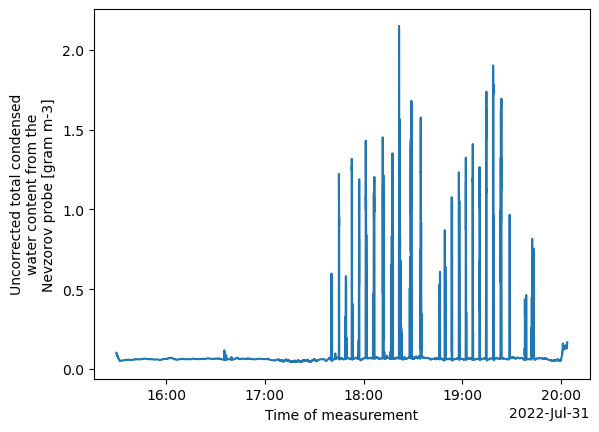

In [34]:
# Your plotting code goes here...

ds_aircraft_core["NV_TWC_U"].plot() #REMOVE

Q8: How does this help us decide when we are measuring cloud?

A8: #REMOVE NV_TWC_U is total condensed water, which spikes when in a cloud. There is some variability at all times so some threshold would be needed to make a mask.

Q9: Does this data confirm your earlier labelling of flight activities during different time periods based on the altitude time series?

A9: #REMOVE Yes, there are no TWC peaks early on when sampling aerosol, and there many peaks during the cloud measurement period.

TASK 3: Watch the aircraft footage as it makes a cloud pass. Think about what this adds compared to the data above?

TASK 4: Take look at the image below. Can you identify which cloud the aicraft flew through in the footage?

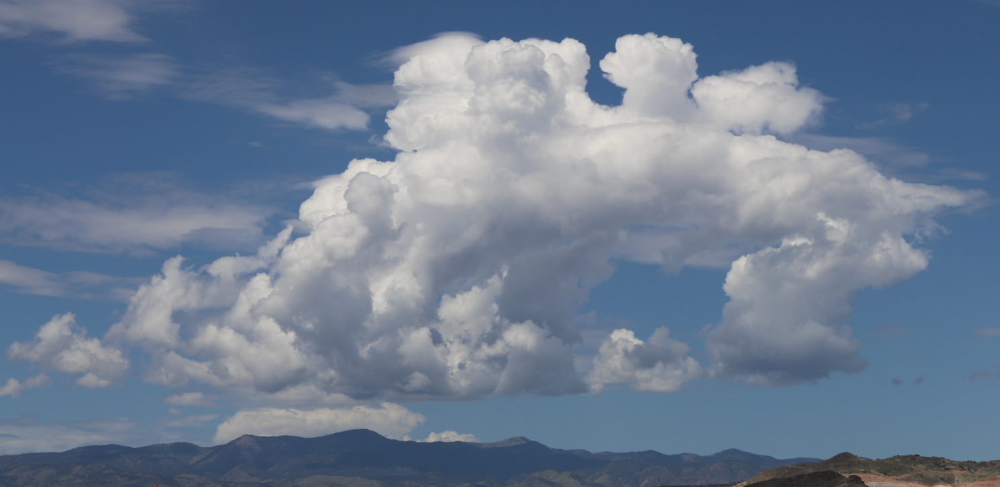

TASK 5: Take a look at ground timelapse in Materials/ground_timelapse. As well as the ascending convective tops, the cloud is also moving in another way?

You can see this process in fine detail at https://commons.wikimedia.org/wiki/File:Timelapse_of_convective_cloud_forming_detrainment_layer_cloud.gif 

PART 1B: PROCESSING OF OBSERVATIONS TO DEVELOP A USEFUL METRIC

We're interested in the convective growth of these clouds, so tracking how their height changes over time would be a useful metric. If we had 2 more or cameras we could use stereo-photogrammetry, but in DCMEX we didn't have a suitable second camera. Instead, we can use the single camera photos to estimate their height with some trigonometry.

(https://github.com/cemac/DCMEX/wiki/Calculating-height-from-pixel-height)

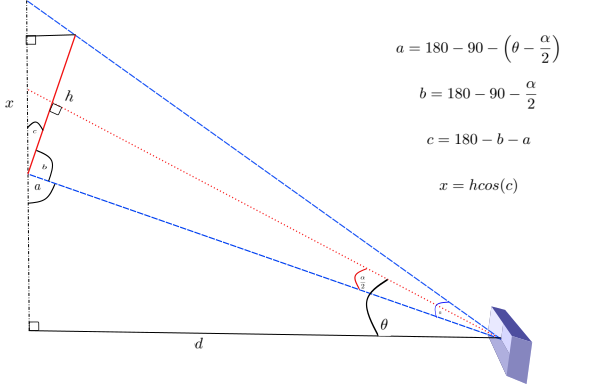

We need the horizontal distance, d, to the cloud. We can estimate d to the deepest part of the cloud by finding the maximum cloud optical depth from the GOES16 geostationary satellite.

https://github.com/cemac/DCMEX/wiki/Estimating-Distance

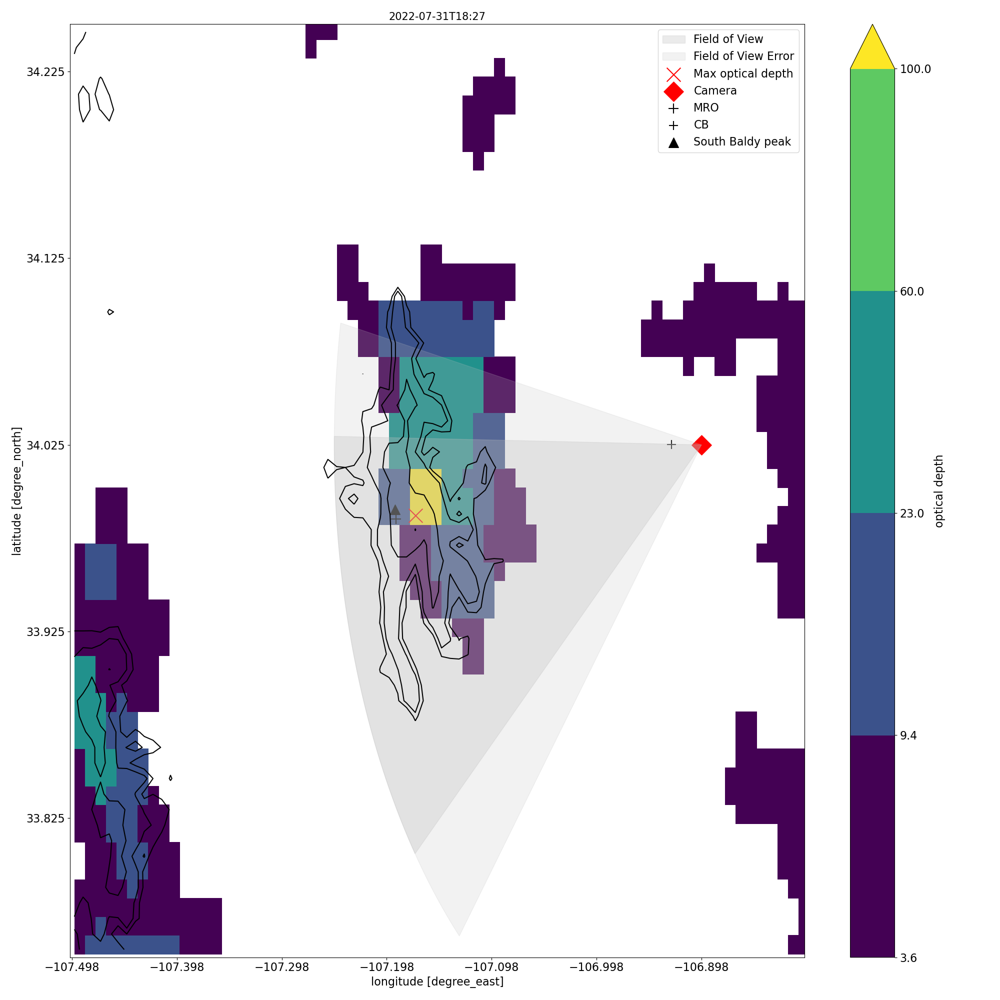

We can use edge finding to pick out the highest height of the cloud in the image.

https://github.com/cemac/DCMEX/wiki/Automatically-Detecting-Cloud-Edges

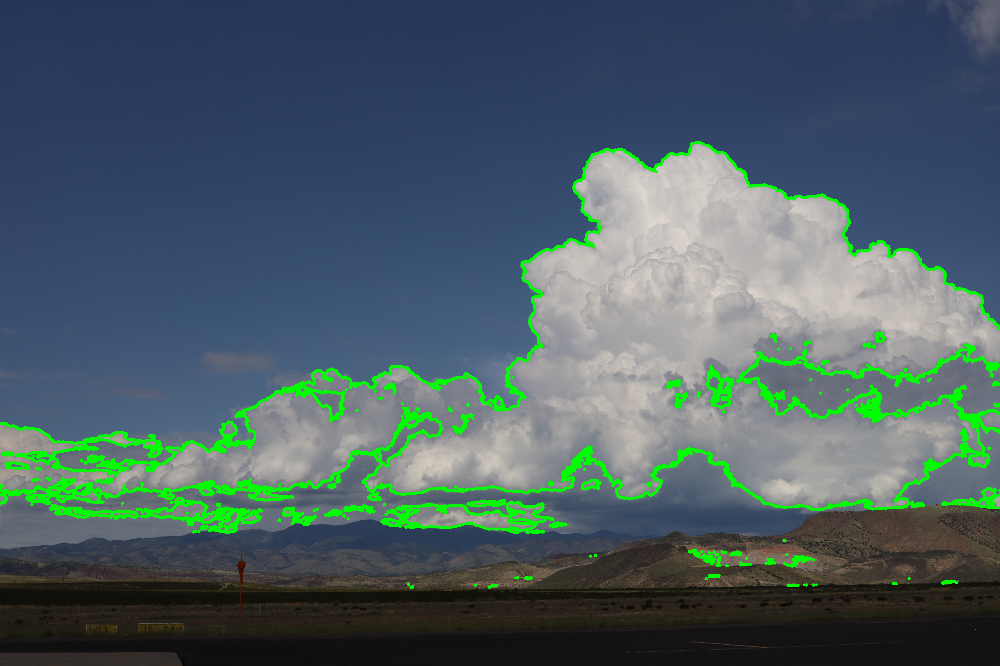 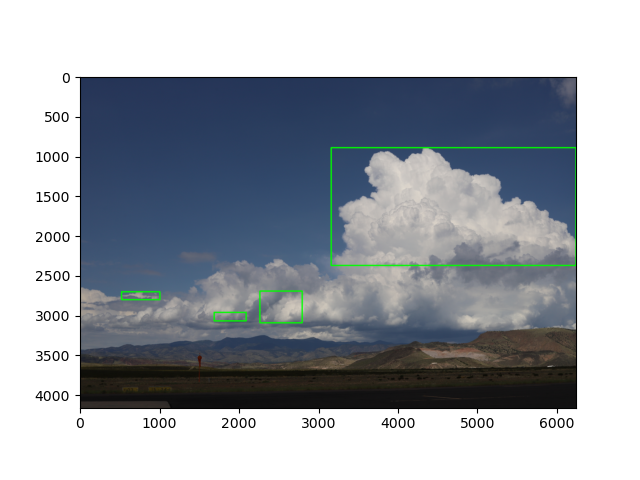

For the cloud we'd been looking at we obtain

https://github.com/cemac/DCMEX/wiki/Outputs

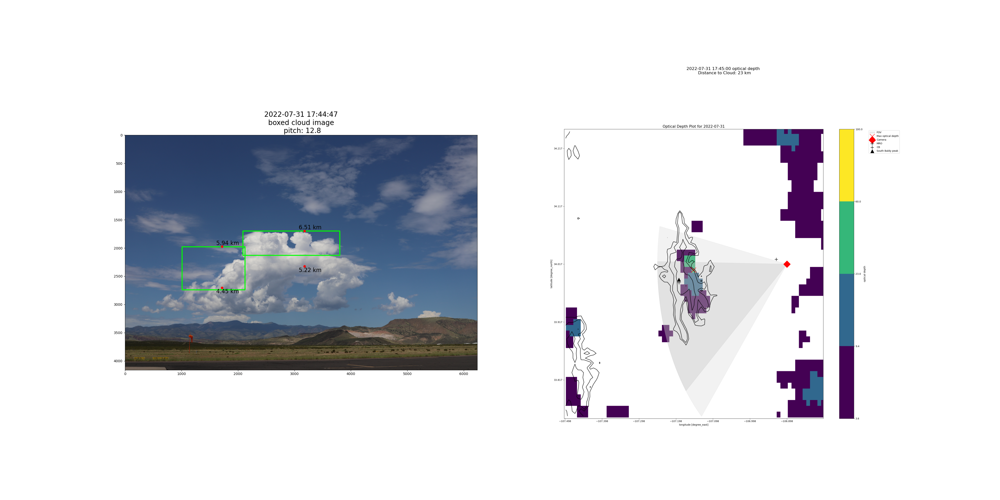

Comparing this for the independent estimate based on FAAM images, we see we are within ???m
<<< FAAM-based height estimation iamge >>>>

Read in the cloud height estimates for our case.


In [47]:
df = pd.read_csv(data_path+"ground_timelapse/2022-07-31_camera_2_cloud_top_heights.csv")
df['Time'] = pd.to_datetime(df['Time']) ## This will make plotting a bit easier
df

,Unnamed: 0,Time,distance_to_cloud,CT1,CT2,CB1,CB2,CTP1,CTP2,CBP1,CTBP2,W1,W2,X1,X2,MAXCTH,CBP2
0,0,2022-07-31 17:01:07,24.844621,4.81,5.65,4.20,5.03,2624,2242,2908,NaN,567,593,2524,1275,5.65,2524.0
1,1,2022-07-31 17:01:27,24.844621,4.85,3.53,4.22,3.23,2609,3210,2895,NaN,779,1914,2323,0,4.85,3350.0
2,2,2022-07-31 17:01:47,24.844621,4.88,3.57,4.16,3.23,2594,3191,2924,NaN,777,1952,2324,0,4.88,3350.0
3,3,2022-07-31 17:02:07,24.844621,4.91,3.54,4.15,3.23,2580,3206,2926,NaN,773,1963,2327,0,4.91,3350.0
4,4,2022-07-31 17:02:27,24.844621,4.93,5.74,3.87,4.23,2570,2199,3054,NaN,468,758,2648,1188,5.74,2889.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503,503,2022-07-31 19:45:55,26.644961,7.01,10.61,6.32,8.12,1794,257,2087,NaN,1646,1928,3994,1459,10.61,1319.0
504,504,2022-07-31 19:46:01,26.644961,7.96,10.91,7.15,8.48,1388,130,1729,NaN,1058,3233,0,1676,10.91,1163.0
505,505,2022-07-31 19:46:21,26.644961,10.91,10.31,10.21,8.61,130,385,426,NaN,2430,1025,3043,2019,10.91,1111.0
506,506,2022-07-31 19:46:41,26.644961,7.40,10.94,6.61,8.54,1627,116,1962,NaN,1205,3582,3711,1864,10.94,1142.0


TASK 6: Use df.plot.scatter() to pLot the MAXCTH against time. You might want to use the option, s, to make the scatter points a more reasonable size.

<Axes: xlabel='Time', ylabel='MAXCTH'>

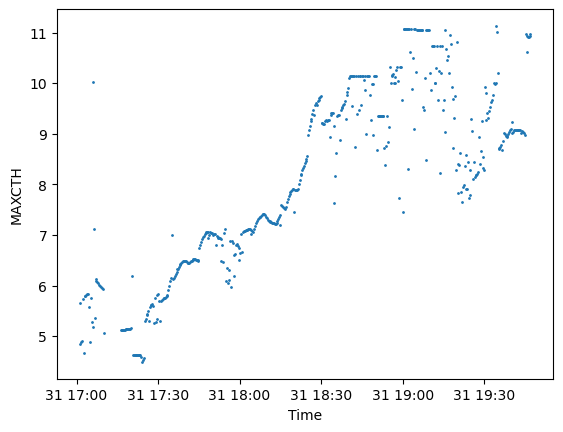

In [17]:
# your code goes here

df.plot.scatter(x="Time",y="MAXCTH", s=1) #REMOVE

Q10: What feature in the reliable part of the series (approx. 17:30 to 18:30) relates to the a process we saw in the cloud timelapse?

A10: #REMOVE at around 17:50 to 18:15 the cloud height doesn't increase much compared to earlier and later times. The cloud is instead detrianing horizontally during that time.

TASK 7: I've picked out height estimate plots from some times where the scatter points seem noisy and inconsistent with surrounding times (17:00, 17:55 and 19:00). Take a look at the images and suggest some issues that the automated cloud tracking has.

PART 1C: COMPARING MODEL DATA TO FIELD OBSERVATIONS

We will read in the cloud outputs from the UM-CASIM model control simulation from this case. Details of these simualtions are available at https://doi.org/10.5194/acp-25-10907-2025

In [6]:
ds_model = xr.open_mfdataset(data_path+"UM-CASIM/20220731T0000Z_LMagda_km1p5set1_expt1_pz01*.nc", decode_timedelta=True)

In [7]:
ds_model

<xarray.Dataset> Size: 8GB
Dimensions:                                           (time: 20,
                                                       model_level_number: 70,
                                                       grid_latitude: 300,
                                                       grid_longitude: 300)
Coordinates:
  * time                                              (time) datetime64[ns] 160B ...
  * model_level_number                                (model_level_number) int32 280B ...
  * grid_latitude                                     (grid_latitude) float32 1kB ...
  * grid_longitude                                    (grid_longitude) float64 2kB ...
    forecast_reference_time                           datetime64[ns] 8B 2022-...
    forecast_period                                   (time) timedelta64[ns] 160B dask.array<chunksize=(4,), meta=np.ndarray>
    level_height                                      (model_level_number) float32 280B dask.array<chunksize=(70,), meta=np.ndarray>
    sigma                                             (model_level_number) float32 280B dask.array<chunksize=(70,), meta=np.ndarray>
    lon                                               (grid_latitude, grid_longitude) float64 720kB dask.array<chunksize=(300, 300), meta=np.ndarray>
    lat                                               (grid_latitude, grid_longitude) float64 720kB dask.array<chunksize=(300, 300), meta=np.ndarray>
Data variables: (12/16)
    number_of_cloud_droplets_per_kg_of_air            (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    number_of_rain_drops_per_kg_of_air                (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    number_of_ice_particles_per_kg_of_air             (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    number_of_snow_aggregates_per_kg_of_air           (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    number_of_graupel_particles_per_kg_of_air         (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    cloud_volume_fraction_in_atmosphere_layer         (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    ...                                                ...
    air_temperature                                   (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    mass_fraction_of_cloud_ice_in_air                 (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    mass_fraction_of_cloud_liquid_water_in_air        (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    mass_fraction_of_graupel_in_air                   (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    mass_fraction_of_rain_in_air                      (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    specific_humidity                                 (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
Attributes: (12/14)
    um_suite:          u-dd455@281404
    casim_branches:    https://code.metoffice.gov.uk/trac/monc/browser/casim/...
    um_branches:       https://code.metoffice.gov.uk/trac/um/browser/main/bra...
    creator_contact:   Declan Finney (d.l.fin

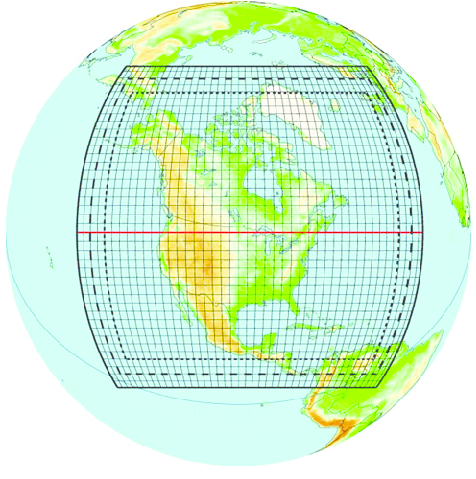

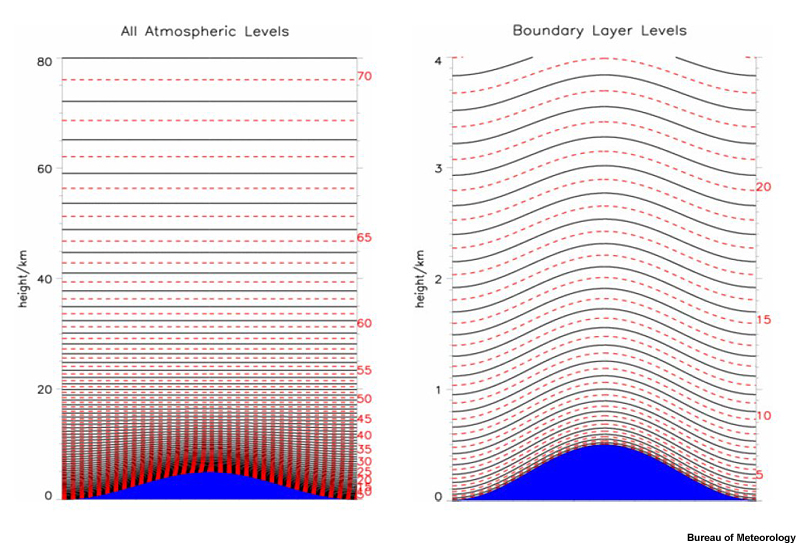


NOTE
1) grid_latitude and grid_longitude are not true latitude and longitude, as the data is on a rotated grid (a common feature of Limitated Area Models (LAMs)). The true lattitude and longitude are stored in the 2D arrays "lat" and "Lon". This was done using functions in the Iris python package. 
2) The UM uses a hybrid height grid where by model levels follow the terrain when close to the ground and then gradually flatten out at higher heights. The variable "level_height" is the hybrid level height not the true height. We will combine level_height with sigma (a set of model parameters defining model levels) and the model orography in order to calculate the true height above sea level.


In [29]:
# read in orog
ds_model_orog = xr.open_dataset(data_path+"UM-CASIM/20220716T0000Z_LMagda_km1p5set1_expt1_pa000_model_orog_rgd.nc")#, decode_timedelta=True)
## calculate the true height
true_level_height_asl = ds_model['level_height'] + ds_model['sigma'] *  ds_model_orog['surface_altitude'] #*  orography_regrid['surface_altitude']
## add as dataset coordinate
ds_model = ds_model.assign_coords(true_level_height_asl=true_level_height_asl)

In [30]:
ds_model

<xarray.Dataset> Size: 8GB
Dimensions:                                           (time: 20,
                                                       model_level_number: 70,
                                                       grid_latitude: 300,
                                                       grid_longitude: 300)
Coordinates:
  * time                                              (time) datetime64[ns] 160B ...
  * model_level_number                                (model_level_number) int32 280B ...
  * grid_latitude                                     (grid_latitude) float32 1kB ...
  * grid_longitude                                    (grid_longitude) float64 2kB ...
    forecast_reference_time                           datetime64[ns] 8B 2022-...
    forecast_period                                   timedelta64[ns] 8B 00:0...
    level_height                                      (model_level_number) float32 280B dask.array<chunksize=(70,), meta=np.ndarray>
    sigma                                             (model_level_number) float32 280B dask.array<chunksize=(70,), meta=np.ndarray>
    lon                                               (grid_latitude, grid_longitude) float64 720kB ...
    lat                                               (grid_latitude, grid_longitude) float64 720kB ...
    true_level_height_asl                             (model_level_number, grid_latitude, grid_longitude) float32 25MB dask.array<chunksize=(70, 300, 300), meta=np.ndarray>
Data variables: (12/16)
    number_of_cloud_droplets_per_kg_of_air            (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    number_of_rain_drops_per_kg_of_air                (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    number_of_ice_particles_per_kg_of_air             (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    number_of_snow_aggregates_per_kg_of_air           (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    number_of_graupel_particles_per_kg_of_air         (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    cloud_volume_fraction_in_atmosphere_layer         (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    ...                                                ...
    air_temperature                                   (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    mass_fraction_of_cloud_ice_in_air                 (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    mass_fraction_of_cloud_liquid_water_in_air        (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    mass_fraction_of_graupel_in_air                   (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    mass_fraction_of_rain_in_air                      (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
    specific_humidity                                 (time, model_level_number, grid_latitude, grid_longitude) float32 504MB dask.array<chunksize=(2, 35, 150, 150), meta=np.ndarray>
Attributes: (12/14)
    um_suite:          u-dd455@281404
    casim_branches:    https://code.metoffice.gov.uk/trac/monc/browser/casim/...
    um_branches:       https://code.metoffice.gov.uk/trac/um/browser/main/bra...
    creat

In [35]:
# We hone in the model to a subdomain around the magdalena mountains where the aircraft flew
min_gridlat = -0.15
max_gridlat = 0.14

min_gridlon = 359.93
max_gridlon = 360.11

ds_model_subdomain = ds_model.sel(grid_longitude=slice(min_gridlon, max_gridlon), grid_latitude=slice(min_gridlat, max_gridlat))

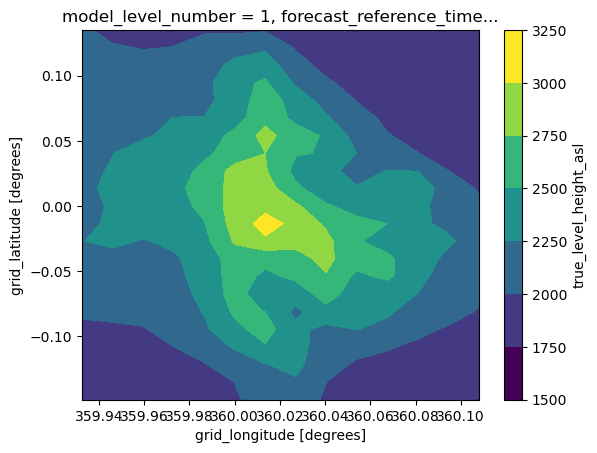

In [36]:
## if we plot the lowest model level then we roughly see the orography of the model
# this mountain should look familiar, i.e. 
ds_model_subdomain["true_level_height_asl"][0].plot.contourf()

In [58]:
# A model grid box is not cloud or clear, it has a cloud fraction between 0 and 1. 
# To make sure we focus on model grid boxes that are mainly cloud we set a minimum cloud fraction.
cond_cloudfrac_min = 0.5
# We make a cloud mask array that is 1 where the condition is met or NaN where it isn't.
cloud_mask = xr.where((ds_model_subdomain["cloud_volume_fraction_in_atmosphere_layer"]>cond_cloudfrac_min), 1, np.nan)
# We use the cloud mask with our level heights array, 
# effectively setting any non-cloud grid cells to NaN so they're not considered in the next step
level_heights_masked = ds_model_subdomain["true_level_height_asl"] * cloud_mask
# We find the maximum cloud height (this function will ignore grid cells that are NaN)
max_cloud_height = level_heights_masked.max(["grid_longitude","grid_latitude","model_level_number"])

# If you look at the aircraft or ground timelapse you will see some high cirrus cloud is present.
# I found the model also that this cloud at 14-15km. 
# Since we are trying to analyse the convective cloud growth, the next lines of code calculate
# a new max cloud height that only looks at grid cells that are underneath that cirrus cloud layer.
cond_cloudheight_max = 14000
level_heights_masked_limited = xr.where(level_heights_masked <= cond_cloudheight_max, level_heights_masked, np.nan)
max_cloud_height_limited = level_heights_masked_limited.max(["grid_longitude","grid_latitude","model_level_number"])



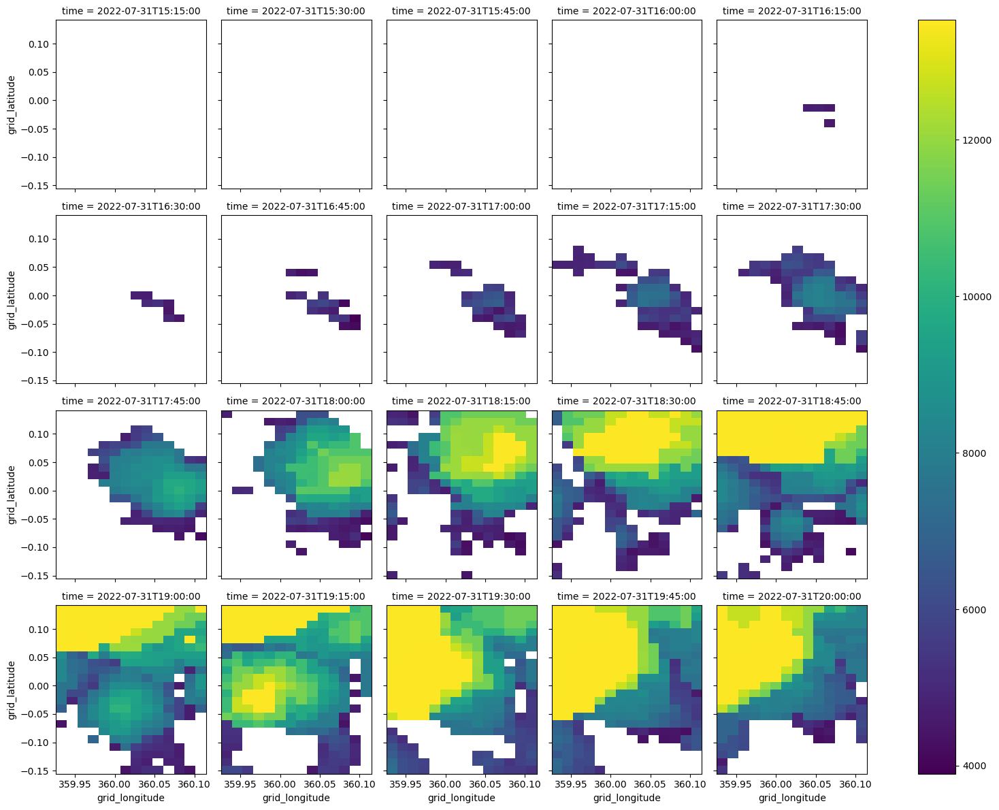

In [61]:
# Plot thumnail maps of column maximum cloud height in order to see the model convective cloud development
level_heights_masked_limited.max(["model_level_number"]).plot(col="time", col_wrap=5)

<Axes: title={'center': 'forecast_reference_time = 2022-07-31, forecast_...'}, xlabel='Time', ylabel='MAXCTH'>

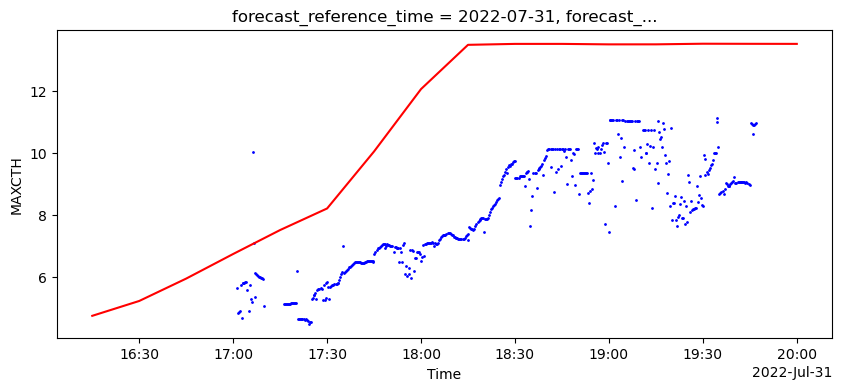

In [67]:
# Plot the maximum model cloud height in the domain with the timelapse observational estimate overlaid
# model heights are in metres, while the observationals estiamtes are km.
fig, ax = plt.subplots(figsize=[10,4])
(max_cloud_height_limited*1e-3).plot(ax=ax, color="red")   # xarray plot on this axis
df.plot.scatter(x="Time", y="MAXCTH", s=1, ax=ax, color="b")


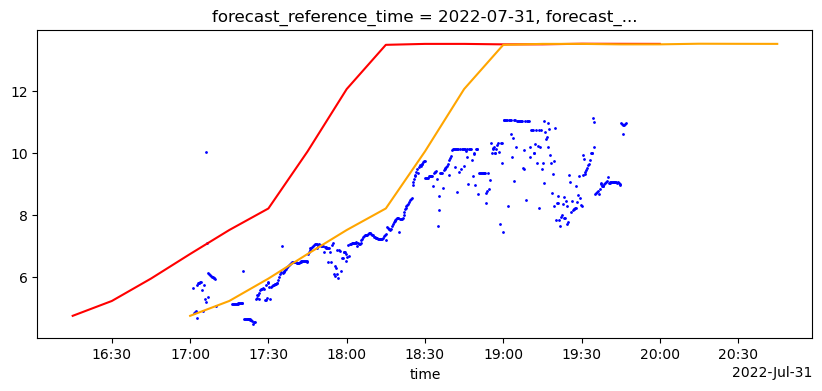

In [69]:
# It looks like the model cloud grows too early. 
# Compare the general growth rates by shifting the model times 45 mins later
# and plotting an additional line for the shifted time series.

# new object shifted 45mins later
max_cloud_height_limited_shifted = max_cloud_height_limited.assign_coords(
    time=max_cloud_height_limited.time + np.timedelta64(45, "m")
)

# Plotting
fig, ax = plt.subplots(figsize=[10,4])
(max_cloud_height_limited*1e-3).plot(ax=ax, color="red")   # xarray plot on this axis
df.plot.scatter(x="Time", y="MAXCTH", s=1, ax=ax, color="b")
(max_cloud_height_limited_shifted*1e-3).plot(ax=ax, color="orange")

DISCUSSION: Why might the model develop convective cloud too early? What might we might want to investigate to understand that?

PART 1D (BONUS): UNDERSTANDING POTENTIAL CAUSES OF SOME MODEL ERRORS USING FIELD OBSERVATIONS

When we adjust the timing of the model, we see it still doesn't capture all aspects of the cloud growth. Notably, it does not show the same pause in growth between 17:45 and 18:15.

DISCUSSION: In reality, what might hold back convective cloud from continously growing?


In [73]:
# Read in the aircraft dropsonde data
ds_aircraft_dsonde = xr.open_dataset(data_path+"aircraft_data/faam-dropsonde_faam_20220731155916_r0_c308_proc.nc")
ds_aircraft_dsonde

<xarray.Dataset> Size: 133kB
Dimensions:         (time: 1578, obs: 1)
Coordinates:
  * time            (time) datetime64[ns] 13kB 2022-07-31T16:05:49.540008544 ...
    lat             (time) float32 6kB ...
    lon             (time) float32 6kB ...
    gpsalt          (time) float32 6kB ...
Dimensions without coordinates: obs
Data variables: (12/27)
    trajectory      |S1 1B ...
    launch_time     datetime64[ns] 8B ...
    pres            (time) float32 6kB ...
    tdry            (time) float32 6kB ...
    dp              (time) float32 6kB ...
    rh              (time) float32 6kB ...
    ...              ...
    reference_rh    (obs) float32 4B ...
    reference_wspd  (obs) float32 4B ...
    reference_wdir  (obs) float32 4B ...
    reference_lat   (obs) float32 4B ...
    reference_lon   (obs) float32 4B ...
    reference_alt   (obs) float32 4B ...
Attributes: (12/93)
    Conventions:            CF-1.6
    RepoRevision:           V3.4.6
    RepoLastChangedDate:    Fri Apr 30 16:17:27 2021 -0600
    RepoId:                 163b1128fa837a96c93dfe8a59c915ff3185b748
    RepoBranch:             HEAD
    featureType:            trajectory
    ...                     ...
    WindQCDev:              999
    WindQCWL:               30
    WindSats:               6
    WindSmoothWL:           10
    WindVVPresWL:           5
    WindVVdelta:            2.5

In [75]:
# When and where was the data collected?
print(ds_aircraft_dsonde["reference_time"].values
      , ds_aircraft_dsonde["reference_lat"].values
      , ds_aircraft_dsonde["reference_lon"].values
     )

['2022-07-31T15:59:16.000000000'] [33.9536] [-107.181]


Text(0.5, 0, 'Environmental temperature (degC)')

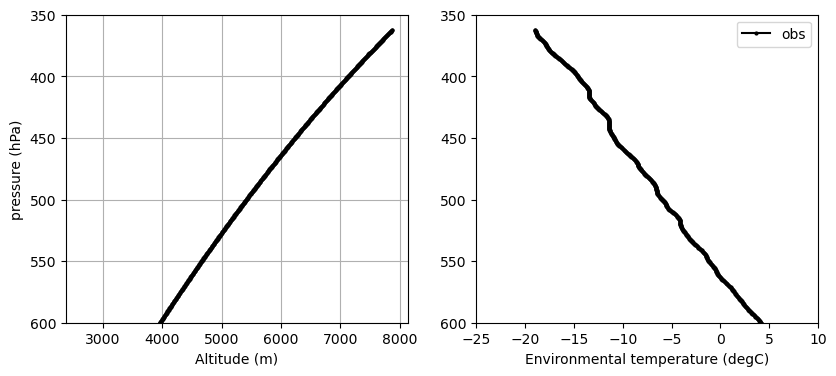

In [76]:
## Plot the dropsonde altitude against pressure to get a feel for how they relate
plt.figure(figsize=[15,4])
plt.subplot(131)
plt.plot(ds_aircraft_dsonde["alt"],ds_aircraft_dsonde["pres"], marker="o", markersize=2,color="k",label="obs")
plt.gca().invert_yaxis()
plt.ylim([600,350])
plt.xlabel("Altitude (m)")
plt.ylabel("pressure (hPa)")
plt.grid()

## And plot the temperature profile as a function of temperature
plt.subplot(132)
plt.plot(ds_aircraft_dsonde["tdry"],ds_aircraft_dsonde["pres"], marker="o", markersize=2,color="k",label="obs")
plt.legend()
plt.gca().invert_yaxis()
plt.ylim([600,350])
plt.xlim([-25,10])
plt.xlabel("Environmental temperature (degC)")

DISCUSSION: What do you notice about the temperature profile?

In [77]:
# Bit of cleanup of data, create a mask where both tdry and pres are finite
mask = np.isfinite(ds_aircraft_dsonde["tdry"]) & np.isfinite(ds_aircraft_dsonde["pres"])
# Apply the mask to get valid data
tdry_valid = ds_aircraft_dsonde["tdry"].values[mask]
pres_valid = ds_aircraft_dsonde["pres"].values[mask]
# Compute the gradient
dTdry_dpres = np.gradient(tdry_valid, pres_valid)

Text(0.5, 0, 'Environmental lapse rate (degC/hPa)')

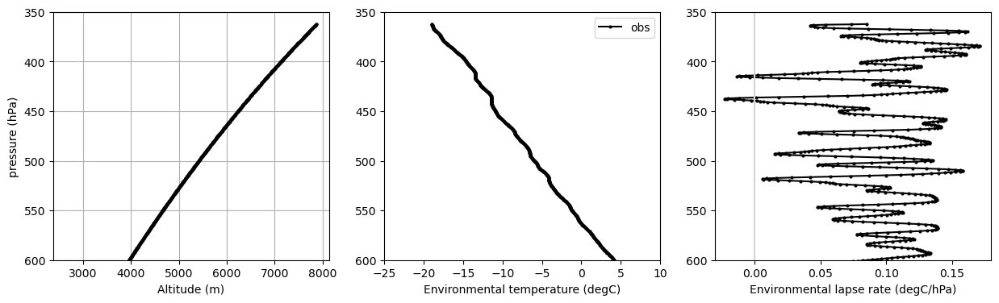

In [79]:
## Add an extra panel looking at dT/dP

plt.figure(figsize=[15,4])
plt.subplot(131)
plt.plot(ds_aircraft_dsonde["alt"],ds_aircraft_dsonde["pres"], marker="o", markersize=2,color="k",label="obs")
plt.gca().invert_yaxis()
plt.ylim([600,350])
plt.xlabel("Altitude (m)")
plt.ylabel("pressure (hPa)")
plt.grid()

plt.subplot(132)
plt.plot(ds_aircraft_dsonde["tdry"],ds_aircraft_dsonde["pres"], marker="o", markersize=2,color="k",label="obs")
plt.legend()
plt.gca().invert_yaxis()
plt.ylim([600,350])
plt.xlim([-25,10])
plt.xlabel("Environmental temperature (degC)")

plt.subplot(133)
plt.plot(dTdry_dpres, pres_valid, marker="o", markersize=2,color="k",label="obs")
plt.gca().invert_yaxis()
plt.ylim([600,350])
plt.axvline(0, color="lightgrey")
plt.xlim([-0.03,0.18])
plt.xlabel("Environmental lapse rate (degC/hPa)")

DISCUSSION: What does the lapse rate mean for convection?

https://firstalerthurricane.com/ever-wanted-to-know-how-to-read-skew-t-charts/
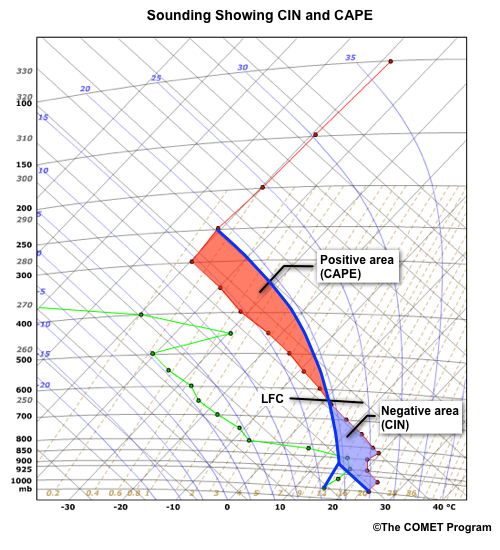

In [168]:
# target point
lat0, lon0 = 33.9536, -107.181   # example

# flatten lat/lon arrays
lat = ds_model['lat'].values
lon = ds_model['lon'].values

# handle periodicity (lon might be 0-360)
#lon0_mod = lon0 % 360
#lon_mod = lon % 360
lon0_mod = ((lon0 + 180) % 360) - 180
lon_mod = ((lon + 180) % 360) - 180

print(lat0,lon0_mod)

# compute distance on sphere (rough, but fine for nearest)
dist = np.sqrt((lat - lat0)**2 + (lon_mod - lon0_mod)**2)

# find indices of nearest gridpoint
j, i = np.unravel_index(dist.argmin(), dist.shape)

print(f"Nearest grid point: lat={lat[j,i]}, lon={lon[j,i]}")

# now select the column at that grid point
ds_model_nearest = ds_model.isel(grid_latitude=j, grid_longitude=i)

33.9536 -107.181
Nearest grid point: lat=33.959498886795416, lon=-107.1837501371694


In [169]:
tindex=3
ds_model_nearest.isel(time=tindex)

<xarray.Dataset> Size: 6kB
Dimensions:                                           (model_level_number: 70)
Coordinates:
    time                                              datetime64[ns] 8B 2022-...
  * model_level_number                                (model_level_number) int32 280B ...
    grid_latitude                                     float32 4B -0.0405
    grid_longitude                                    float64 8B 360.0
    forecast_reference_time                           datetime64[ns] 8B 2022-...
    forecast_period                                   timedelta64[ns] 8B 00:0...
    level_height                                      (model_level_number) float32 280B dask.array<chunksize=(70,), meta=np.ndarray>
    sigma                                             (model_level_number) float32 280B dask.array<chunksize=(70,), meta=np.ndarray>
    lon                                               float64 8B -107.2
    lat                                               float64 8B 33.96
    true_level_height_asl                             (model_level_number) float32 280B dask.array<chunksize=(70,), meta=np.ndarray>
Data variables: (12/16)
    number_of_cloud_droplets_per_kg_of_air            (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    number_of_rain_drops_per_kg_of_air                (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    number_of_ice_particles_per_kg_of_air             (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    number_of_snow_aggregates_per_kg_of_air           (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    number_of_graupel_particles_per_kg_of_air         (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    cloud_volume_fraction_in_atmosphere_layer         (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    ...                                                ...
    air_temperature                                   (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    mass_fraction_of_cloud_ice_in_air                 (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    mass_fraction_of_cloud_liquid_water_in_air        (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    mass_fraction_of_graupel_in_air                   (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    mass_fraction_of_rain_in_air                      (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
    specific_humidity                                 (model_level_number) float32 280B dask.array<chunksize=(35,), meta=np.ndarray>
Attributes: (12/14)
    um_suite:          u-dd455@281404
    casim_branches:    https://code.metoffice.gov.uk/trac/monc/browser/casim/...
    um_branches:       https://code.metoffice.gov.uk/trac/um/browser/main/bra...
    creator_contact:   Declan Finney (d.l.finney@leeds.ac.uk), University of ...
    title:             Simulations over the southwest USA for the DCMEX campa...
    institution:       Generated on UK Met Office Monsoon computing facility,...
    ...                ...
    coord_system:      RotatedGeogCS(56.0, 72.80000305175781, ellipsoid=GeogC...
    conventions:       CF-1.7
    expt_name:         ctl
    NCO:               netCDF Operators version 5.2.7 (Homepage = http://nco....
    history:           Fri Feb 28 15:13:27 2025: ncatted -O -a expt_descripti...
    expt_description:  Control experiment using 250E6 kg-1 fixed droplet numb...

In [170]:
ds_model_nearest_tnearest = ds_model_nearest.isel(time=tindex)

In [171]:
dTdry_dpres_model = np.gradient((ds_model_nearest_tnearest["air_temperature"]-273.15), (0.01*ds_model_nearest_tnearest["air_pressure"]))

Text(0.5, 0, 'Environmental lapse rate (degC/hPa)')

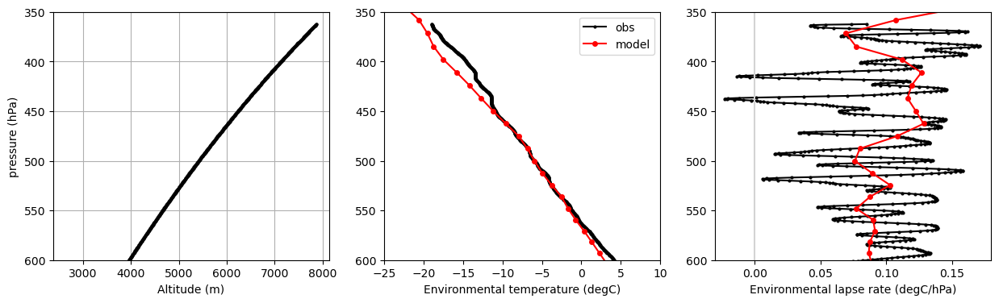

In [172]:
plt.figure(figsize=[15,4])
plt.subplot(131)
plt.plot(ds_aircraft_dsonde["alt"],ds_aircraft_dsonde["pres"], marker="o", markersize=2,color="k",label="obs")
plt.gca().invert_yaxis()
plt.ylim([600,350])
plt.xlabel("Altitude (m)")
plt.ylabel("pressure (hPa)")
plt.grid()

plt.subplot(132)
plt.plot(ds_aircraft_dsonde["tdry"],ds_aircraft_dsonde["pres"], marker="o", markersize=2,color="k",label="obs")
plt.plot(ds_model_nearest_tnearest["air_temperature"]-273.15,0.01*ds_model_nearest_tnearest["air_pressure"],marker="o", markersize=4,color="r",label="model")
plt.legend()
plt.gca().invert_yaxis()
plt.ylim([600,350])
plt.xlim([-25,10])
plt.xlabel("Environmental temperature (degC)")

plt.subplot(133)
plt.plot(dTdry_dpres, pres_valid, marker="o", markersize=2,color="k",label="obs")
plt.plot(dTdry_dpres_model,0.01*ds_model_nearest_tnearest["air_pressure"],marker="o", markersize=4,color="r",label="model")
plt.gca().invert_yaxis()
plt.ylim([600,350])
plt.axvline(0, color="lightgrey")
plt.xlim([-0.03,0.18])
plt.xlabel("Environmental lapse rate (degC/hPa)")

> note that the model does not have the inflections

-----------------

PART 2A: GETTING TO KNOW AIRCRAFT OBSERVATIONS OF CLOUD PARTICLES

We will use a new case, the 30th July 2022. 
<show timelapse in slides, describe how it differs, notably grows rapidly and moves northward instead of staying stationary>

<in accompanying slides: reminder of 2DS instrument and images it collects>

TASK X: Refer to the reference classified images, and decide on labels for the images below.
<have maybe 10 images spanning a range of categories (can take from Jaffeux dataset if better), also include some that are easier and some harder to classify>
<give people a few mins to look and then go over answers as a group. make the point about how long it takes and say how many such images (i.e. >300um) we have from the 2DS campaign>
<reminder on the jaffeux model>

PART 2B: USING MACHINE-LEARNING LABELLED IMAGES TO STUDY GRAUPEL

<slides reminder of Jaffeuz model, and of graupel and it's role - state that CP is the category we will use to represent graupel>

In [ ]:
# read in csv of images labels> csv should just contain the images from the passes of interest>

In [ ]:
# convert images to a graupel concentration using the simplest code possible<

In [180]:
# make a histogram plot of graupel concentration (using simplest code possible) (no need to subset yet?)<

PART 2C: COMPARING MODEL DATA TO AIRCRAFT OBSERVATIONS OF GRAUPEL

~ give a reminder of how CASIM model represents 5 hyrdo species, with mass and number. and note that the range of sizes of particles is not simulated but is inferred from the mass, number and some fixed parameters for the species (don't go into much detail at all).

In [178]:
# read in model data containing graupel
# subset the domain

In [179]:
# thumbnail plot of max column graupel with col="time" (similar to the plot I made in PART 1C)

## discuss whether the timing of the storm seems broadly aligned with the formation in the timelapse
# and whether graupel is present during the passes that we measured graupel in

In [ ]:
# Select a sensible set of model times

In [181]:
# Introduce issue that 2DS only measures a certain size range. The model is repreenting all graupel sizes, so we need to subset that.
## don't go into detail, but prvide a function that calculates graupel number concentration within the 2DS size range.

In [182]:
# make histogram of graupel concetrations from model and overlay the obs 
# (I wonder if we, first, see what this looks like without compositing by w?
# if it seems useful enough then we won't bother with w

# discuss potential sources of bias and what next steps could imprve the comparison, 
# e.g. honing in on updraughts as this is more likely to focus on the initial graupel formation.

PART 2D (BONUS): USING MODEL SENSITIVITY EXPERIMENTS TO EXPLORE POTENTIAL DEVELOPMENT OPTIONS

In [183]:
## Don't need to do this (so get everything else in place first, but once we know the biases,
# we could select one of the sensitivity expts to read in and compare to the ctl model and obs.
# then explian why that sensitivity might modify graupel conc

? plot of mine to give us clues for which expt to look at ?
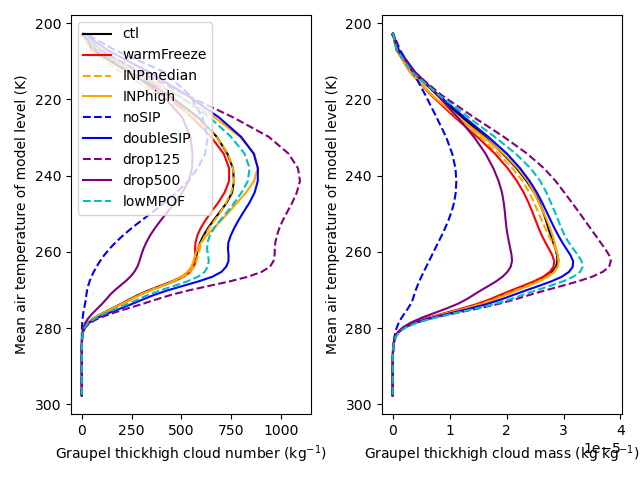